In [ ]:
import tensorflow as tf
import tensorflow_datasets as tfds
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.metrics import confusion_matrix
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, Activation, BatchNormalization
from tensorflow.keras.models import Model

In [ ]:
# Function to load data
def load_data(dataset_name, split):
    (train_dataset, validation_dataset, test_dataset), info = tfds.load(
        dataset_name,
        split=split,
        as_supervised=True,
        with_info=True
    )
    return train_dataset, validation_dataset, test_dataset, info

In [ ]:
# Function to apply preprocessing
def apply_preprocessing(dataset, preprocessing_fn):
    return dataset.map(preprocessing_fn).shuffle(1024).batch(32)

In [ ]:
# Basic preprocessing function
def basic_preprocess(image, label):
    image = tf.cast(image, tf.float32) / 255.0
    image = tf.image.resize(image, [256, 256])
    return image, label

In [ ]:
# Augmentation preprocessing function
def augmented_preprocess(image, label):
    image = tf.cast(image, tf.float32) / 255.0
    image = tf.image.random_flip_left_right(image)
    image = tf.image.random_brightness(image, max_delta=0.1)
    image = tf.image.resize(image, [256, 256])
    return image, label

In [ ]:
def create_cnn_model(model_type, num_classes):
    if model_type == 'basic':
        model = tf.keras.Sequential([
            Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
            MaxPooling2D((2, 2)),
            Conv2D(64, (3, 3), activation='relu'),
            MaxPooling2D((2, 2)),
            Conv2D(128, (3, 3), activation='relu'),
            Flatten(),
            Dense(128, activation='relu'),
            Dense(num_classes, activation='softmax')
        ])
    elif model_type == 'basic_bn':
        model = tf.keras.Sequential([
            Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
            BatchNormalization(),
            MaxPooling2D((2, 2)),
            Conv2D(64, (3, 3), activation='relu'),
            BatchNormalization(),
            MaxPooling2D((2, 2)),
            Conv2D(128, (3, 3), activation='relu'),
            BatchNormalization(),
            Flatten(),
            Dense(128, activation='relu'),
            BatchNormalization(),
            Dense(num_classes, activation='softmax')
        ])
    elif model_type == 'dropout':
        model = tf.keras.Sequential([
            Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
            BatchNormalization(),
            MaxPooling2D((2, 2)),
            Dropout(0.25),
            Conv2D(64, (3, 3), activation='relu'),
            BatchNormalization(),
            MaxPooling2D((2, 2)),
            Dropout(0.25),
            Conv2D(128, (3, 3), activation='relu'),
            BatchNormalization(),
            Dropout(0.25),
            Flatten(),
            Dense(128, activation='relu'),
            BatchNormalization(),
            Dropout(0.5),
            Dense(num_classes, activation='softmax')
        ])
    elif model_type == 'advanced':
        model = tf.keras.Sequential([
            Conv2D(32, (3, 3), padding="same", input_shape=(256, 256, 3)),
            Activation("relu"),
            BatchNormalization(),
            MaxPooling2D(pool_size=(3, 3)),
            Dropout(0.25),
            Conv2D(64, (3, 3), padding="same"),
            Activation("relu"),
            BatchNormalization(),
            Conv2D(64, (3, 3), padding="same"),
            Activation("relu"),
            BatchNormalization(),
            MaxPooling2D(pool_size=(2, 2)),
            Dropout(0.25),
            Conv2D(128, (3, 3), padding="same"),
            Activation("relu"),
            BatchNormalization(),
            Conv2D(128, (3, 3), padding="same"),
            Activation("relu"),
            BatchNormalization(),
            MaxPooling2D(pool_size=(2, 2)),
            Dropout(0.25),
            Flatten(),
            Dense(1024),
            Activation("relu"),
            BatchNormalization(),
            Dropout(0.5),
            Dense(num_classes, activation="softmax")
        ])

    model.compile(
        optimizer='adam',
        loss='sparse_categorical_crossentropy',
        metrics=['accuracy']
    )
    return model

In [ ]:
def plot_confusion_matrix(cm, classes, title='Confusion Matrix'):
    plt.figure(figsize=(15, 15))
    sns.heatmap(cm, annot=True, fmt="d", linewidths=.5, cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.title(title)
    plt.show()

In [ ]:
# Function to train and evaluate a model
def train_and_evaluate(model, train_dataset, validation_dataset, test_dataset, info, epochs):
    history = model.fit(
        train_dataset,
        epochs=epochs,
        validation_data=validation_dataset
    )
    test_loss, test_accuracy = model.evaluate(test_dataset)
    print(f"Test accuracy for {model.name}: {test_accuracy}")

    # Plot training and validation accuracy and loss
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Training Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Training and Validation Accuracy')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Training and Validation Loss')
    plt.legend()
    plt.show()

    return history

In [ ]:
def visualize_activation_maps(model, image):
    # Create a model to fetch the outputs of the intermediate layers
    layer_outputs = [layer.output for layer in model.layers if isinstance(layer, Conv2D)]
    activation_model = Model(inputs=model.input, outputs=layer_outputs)
    activations = activation_model.predict(np.expand_dims(image, axis=0))

    # Display the feature maps
    for layer_idx, layer_activation in enumerate(activations):
        plt.figure(figsize=(20, 20))
        layer_activation = np.array(layer_activation)
        num_features = layer_activation.shape[-1]

        size = layer_activation.shape[1]
        n_cols = num_features // 16  # Displaying 16 feature maps per row
        display_grid = np.zeros((size * n_cols, 16 * size))

        for col in range(n_cols):
            for row in range(16):
                feature_map = layer_activation[0, :, :, col * 16 + row]
                feature_map -= feature_map.mean()
                feature_map /= feature_map.std() + 1e-5
                feature_map *= 64
                feature_map += 128
                feature_map = np.clip(feature_map, 0, 255).astype('uint8')
                display_grid[col * size : (col + 1) * size, row * size : (row + 1) * size] = feature_map

        scale = 20. / size
        plt.figure(figsize=(scale * display_grid.shape[1], scale * display_grid.shape[0]))
        plt.title(model.layers[layer_idx].name)  # Corrected to access the layer by its index
        plt.grid(False)
        plt.imshow(display_grid, aspect='auto', cmap='Blues')
        plt.show()


In [ ]:
def evaluate_best_model(best_model, test_dataset, info, image):
    # Generate predictions to calculate confusion matrix
    y_pred = best_model.predict(test_dataset)
    y_pred_classes = np.argmax(y_pred, axis=1)
    y_true = np.concatenate([y for _, y in test_dataset], axis=0)

    cm = confusion_matrix(y_true, y_pred_classes)
    plot_confusion_matrix(cm, classes=info.features['label'].names)

    # Visualize activation maps
    visualize_activation_maps(best_model, image)

In [ ]:
def run_all_models(preprocessing_types, models, epochs=10):
    results = {}
    best_model = None
    best_accuracy = 0
    best_model_details = {}

    for preprocessing, dataset in preprocessing_types.items():
        train_dataset, validation_dataset, test_dataset, info = dataset
        results[preprocessing] = {}
        for model_type in models:
            print(f"Running {model_type} model with {preprocessing} preprocessing...")
            model = create_cnn_model(model_type, info.features['label'].num_classes)
            history = train_and_evaluate(model, train_dataset, validation_dataset, test_dataset, info, epochs)
            results[preprocessing][model_type] = {
                'history': history,
                'model': model
            }

            # Check if this model has the best validation accuracy
            max_val_accuracy = max(history.history['val_accuracy'])
            if max_val_accuracy > best_accuracy:
                best_accuracy = max_val_accuracy
                best_model = model
                best_model_details = {
                    'model_type': model_type,
                    'preprocessing': preprocessing,
                    'accuracy': best_accuracy,
                    'history': history
                }

    print(f"Best Model: {best_model_details['model_type']} with {best_model_details['preprocessing']} preprocessing")
    print(f"Best Validation Accuracy: {best_model_details['accuracy']}")

    return results, best_model, best_model_details

In [ ]:
model_types = ['basic', 'basic_bn', 'dropout', 'advanced']

In [ ]:
# Load raw data
train_dataset_raw, validation_dataset_raw, test_dataset_raw, info = load_data(
    'plant_village',
    split=['train[:70%]', 'train[70%:85%]', 'train[85%:]']
)

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/1 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/54303 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/plant_village/1.0.2.incompletePVE2VM/plant_village-train.tfrecord*...:   0…

Dataset plant_village downloaded and prepared to /root/tensorflow_datasets/plant_village/1.0.2. Subsequent calls will reuse this data.


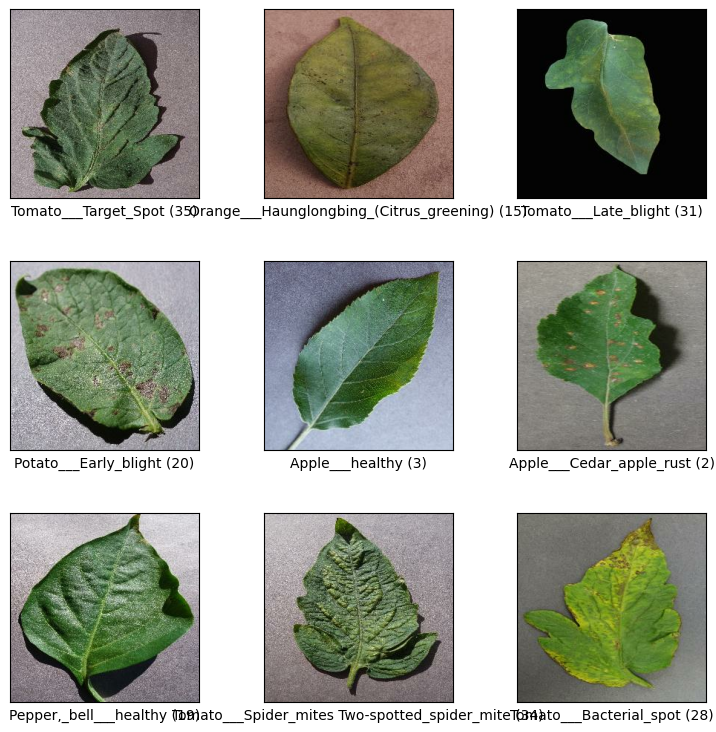

In [ ]:
fig = tfds.show_examples(train_dataset_raw, info)

In [ ]:
# Apply preprocessing
train_dataset_basic = apply_preprocessing(train_dataset_raw, basic_preprocess)
validation_dataset_basic = apply_preprocessing(validation_dataset_raw, basic_preprocess)
test_dataset_basic = apply_preprocessing(test_dataset_raw, basic_preprocess)

train_dataset_augmented = apply_preprocessing(train_dataset_raw, augmented_preprocess)
validation_dataset_augmented = apply_preprocessing(validation_dataset_raw, augmented_preprocess)
test_dataset_augmented = apply_preprocessing(test_dataset_raw, augmented_preprocess)

In [ ]:
# Dictionary of preprocessing types and their corresponding datasets
preprocessing_types = {
    'basic': (train_dataset_basic, validation_dataset_basic, test_dataset_basic, info),
    'augmented': (train_dataset_augmented, validation_dataset_augmented, test_dataset_augmented, info)
}

Running basic model with basic preprocessing...
Epoch 1/10
1188/1188 [==============================] - 35s 24ms/step - loss: 1.0793 - accuracy: 0.6974 - val_loss: 0.5019 - val_accuracy: 0.8421
Epoch 2/10
1188/1188 [==============================] - 27s 22ms/step - loss: 0.3862 - accuracy: 0.8787 - val_loss: 0.4154 - val_accuracy: 0.8699
Epoch 3/10
1188/1188 [==============================] - 27s 22ms/step - loss: 0.2135 - accuracy: 0.9303 - val_loss: 0.6113 - val_accuracy: 0.8411
Epoch 4/10
1188/1188 [==============================] - 27s 22ms/step - loss: 0.1399 - accuracy: 0.9548 - val_loss: 0.4280 - val_accuracy: 0.8849
Epoch 5/10
1188/1188 [==============================] - 27s 22ms/step - loss: 0.0904 - accuracy: 0.9715 - val_loss: 0.6997 - val_accuracy: 0.8472
Epoch 6/10
1188/1188 [==============================] - 27s 22ms/step - loss: 0.0953 - accuracy: 0.9705 - val_loss: 0.7516 - val_accuracy: 0.8538
Epoch 7/10
1188/1188 [==============================] - 27s 22ms/step - loss

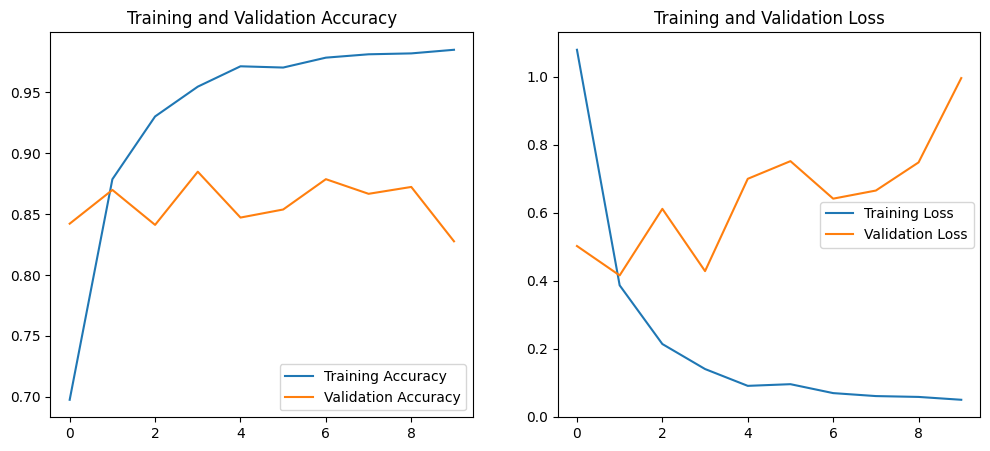

Running basic_bn model with basic preprocessing...
Epoch 1/10
1188/1188 [==============================] - 40s 31ms/step - loss: 0.6814 - accuracy: 0.8065 - val_loss: 0.6430 - val_accuracy: 0.7970
Epoch 2/10
1188/1188 [==============================] - 37s 31ms/step - loss: 0.2197 - accuracy: 0.9339 - val_loss: 0.4081 - val_accuracy: 0.8752
Epoch 3/10
1188/1188 [==============================] - 37s 31ms/step - loss: 0.1065 - accuracy: 0.9688 - val_loss: 0.9929 - val_accuracy: 0.7488
Epoch 4/10
1188/1188 [==============================] - 37s 31ms/step - loss: 0.0742 - accuracy: 0.9767 - val_loss: 0.6131 - val_accuracy: 0.8246
Epoch 5/10
1188/1188 [==============================] - 37s 31ms/step - loss: 0.0523 - accuracy: 0.9841 - val_loss: 1.7739 - val_accuracy: 0.6557
Epoch 6/10
1188/1188 [==============================] - 37s 31ms/step - loss: 0.0403 - accuracy: 0.9871 - val_loss: 0.7513 - val_accuracy: 0.8044
Epoch 7/10
1188/1188 [==============================] - 37s 31ms/step - l

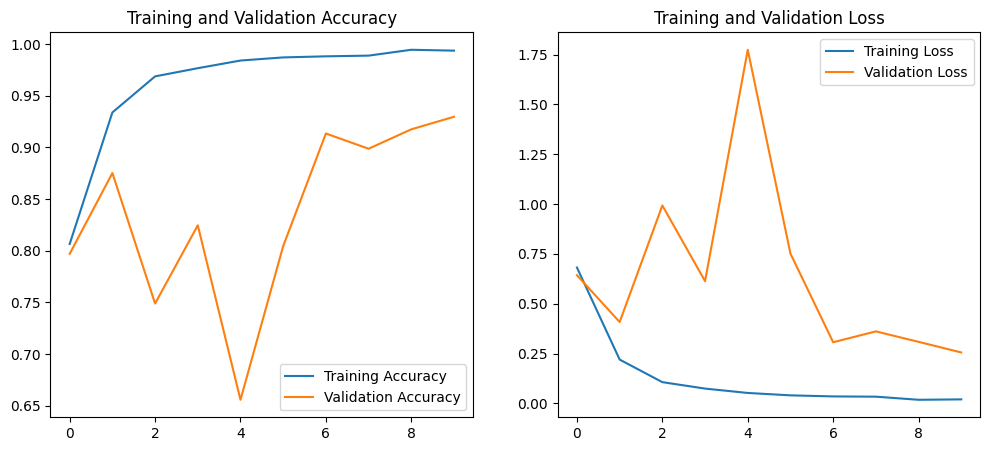

Running dropout model with basic preprocessing...
Epoch 1/10
1188/1188 [==============================] - 52s 39ms/step - loss: 1.0752 - accuracy: 0.6970 - val_loss: 0.6975 - val_accuracy: 0.7914
Epoch 2/10
1188/1188 [==============================] - 44s 37ms/step - loss: 0.5080 - accuracy: 0.8449 - val_loss: 0.9015 - val_accuracy: 0.7514
Epoch 3/10
1188/1188 [==============================] - 44s 37ms/step - loss: 0.3347 - accuracy: 0.8957 - val_loss: 0.8789 - val_accuracy: 0.7309
Epoch 4/10
1188/1188 [==============================] - 45s 37ms/step - loss: 0.2245 - accuracy: 0.9291 - val_loss: 0.4356 - val_accuracy: 0.8802
Epoch 5/10
1188/1188 [==============================] - 44s 37ms/step - loss: 0.1589 - accuracy: 0.9490 - val_loss: 0.2372 - val_accuracy: 0.9202
Epoch 6/10
1188/1188 [==============================] - 44s 37ms/step - loss: 0.1176 - accuracy: 0.9628 - val_loss: 1.6808 - val_accuracy: 0.7027
Epoch 7/10
1188/1188 [==============================] - 44s 37ms/step - lo

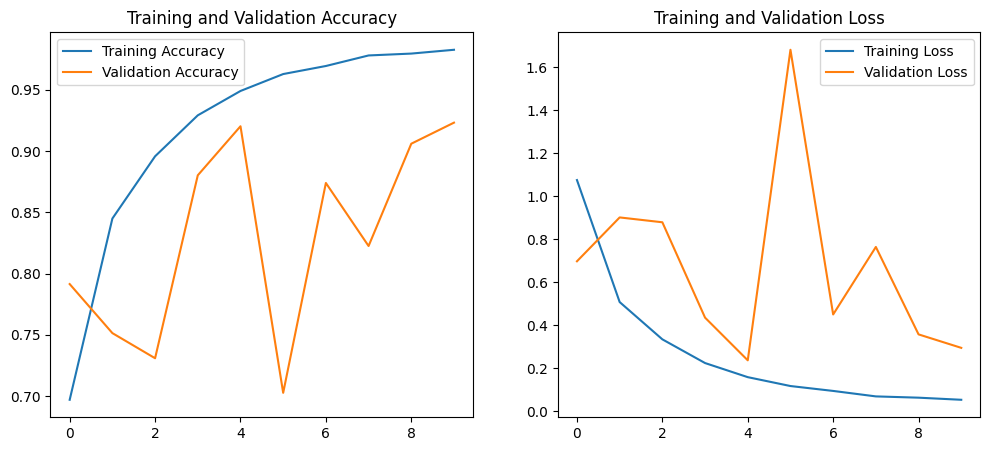

Running advanced model with basic preprocessing...
Epoch 1/10
1188/1188 [==============================] - 52s 39ms/step - loss: 0.9980 - accuracy: 0.7192 - val_loss: 1.1345 - val_accuracy: 0.7108
Epoch 2/10
1188/1188 [==============================] - 44s 37ms/step - loss: 0.5072 - accuracy: 0.8456 - val_loss: 1.2728 - val_accuracy: 0.6780
Epoch 3/10
1188/1188 [==============================] - 44s 37ms/step - loss: 0.3697 - accuracy: 0.8845 - val_loss: 2.6480 - val_accuracy: 0.5971
Epoch 4/10
1188/1188 [==============================] - 44s 37ms/step - loss: 0.2867 - accuracy: 0.9098 - val_loss: 0.7496 - val_accuracy: 0.7999
Epoch 5/10
1188/1188 [==============================] - 44s 37ms/step - loss: 0.2369 - accuracy: 0.9260 - val_loss: 0.1929 - val_accuracy: 0.9406
Epoch 6/10
1188/1188 [==============================] - 44s 37ms/step - loss: 0.1523 - accuracy: 0.9519 - val_loss: 1.1343 - val_accuracy: 0.7521
Epoch 7/10
1188/1188 [==============================] - 44s 37ms/step - l

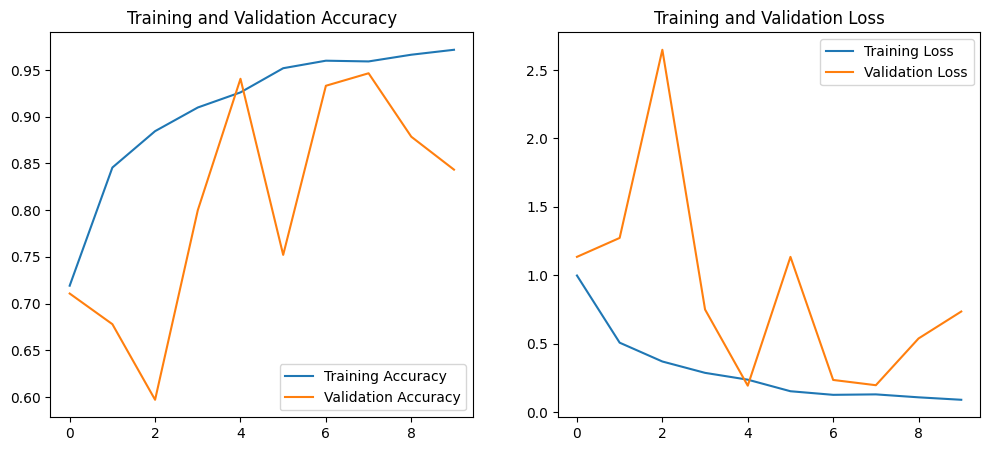

Running basic model with augmented preprocessing...
Epoch 1/10
1188/1188 [==============================] - 29s 23ms/step - loss: 1.1434 - accuracy: 0.6814 - val_loss: 0.6117 - val_accuracy: 0.8089
Epoch 2/10
1188/1188 [==============================] - 28s 23ms/step - loss: 0.4511 - accuracy: 0.8581 - val_loss: 0.4498 - val_accuracy: 0.8548
Epoch 3/10
1188/1188 [==============================] - 28s 23ms/step - loss: 0.3004 - accuracy: 0.9052 - val_loss: 0.4094 - val_accuracy: 0.8736
Epoch 4/10
1188/1188 [==============================] - 28s 23ms/step - loss: 0.2100 - accuracy: 0.9339 - val_loss: 0.4841 - val_accuracy: 0.8598
Epoch 5/10
1188/1188 [==============================] - 28s 23ms/step - loss: 0.1736 - accuracy: 0.9454 - val_loss: 0.3925 - val_accuracy: 0.8879
Epoch 6/10
1188/1188 [==============================] - 28s 23ms/step - loss: 0.1279 - accuracy: 0.9593 - val_loss: 0.4744 - val_accuracy: 0.8819
Epoch 7/10
1188/1188 [==============================] - 28s 23ms/step - 

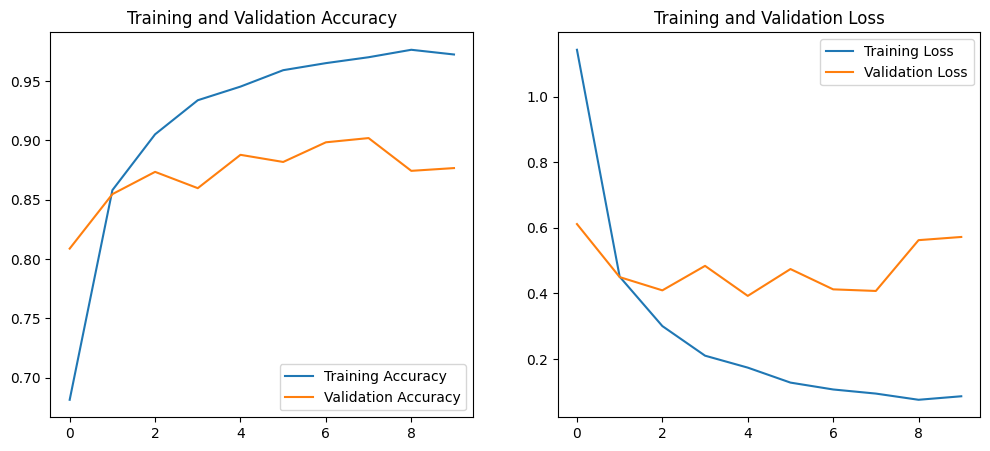

Running basic_bn model with augmented preprocessing...
Epoch 1/10
1188/1188 [==============================] - 41s 32ms/step - loss: 0.7639 - accuracy: 0.7836 - val_loss: 0.8035 - val_accuracy: 0.7649
Epoch 2/10
1188/1188 [==============================] - 38s 31ms/step - loss: 0.3034 - accuracy: 0.9060 - val_loss: 0.6570 - val_accuracy: 0.8191
Epoch 3/10
1188/1188 [==============================] - 38s 31ms/step - loss: 0.1961 - accuracy: 0.9396 - val_loss: 0.2800 - val_accuracy: 0.9100
Epoch 4/10
1188/1188 [==============================] - 38s 31ms/step - loss: 0.1273 - accuracy: 0.9601 - val_loss: 1.8740 - val_accuracy: 0.6268
Epoch 5/10
1188/1188 [==============================] - 38s 31ms/step - loss: 0.1002 - accuracy: 0.9676 - val_loss: 0.6021 - val_accuracy: 0.8233
Epoch 6/10
1188/1188 [==============================] - 38s 31ms/step - loss: 0.0715 - accuracy: 0.9769 - val_loss: 0.5764 - val_accuracy: 0.8354
Epoch 7/10
1188/1188 [==============================] - 38s 31ms/step

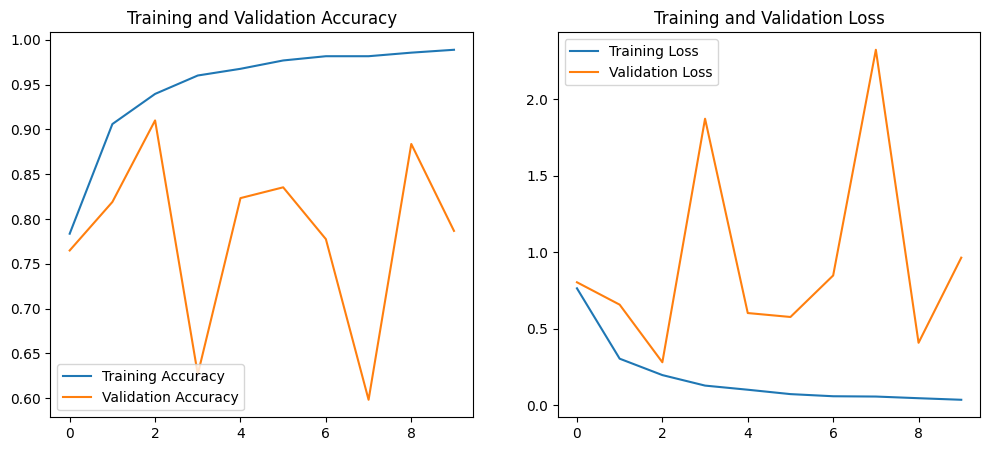

Running dropout model with augmented preprocessing...
Epoch 1/10
1188/1188 [==============================] - 48s 38ms/step - loss: 1.1825 - accuracy: 0.6711 - val_loss: 0.7036 - val_accuracy: 0.7857
Epoch 2/10
1188/1188 [==============================] - 45s 38ms/step - loss: 0.5771 - accuracy: 0.8251 - val_loss: 0.4128 - val_accuracy: 0.8772
Epoch 3/10
1188/1188 [==============================] - 45s 38ms/step - loss: 0.4177 - accuracy: 0.8720 - val_loss: 0.4173 - val_accuracy: 0.8646
Epoch 4/10
1188/1188 [==============================] - 45s 38ms/step - loss: 0.3278 - accuracy: 0.8975 - val_loss: 0.7712 - val_accuracy: 0.7935
Epoch 5/10
1188/1188 [==============================] - 45s 38ms/step - loss: 0.2596 - accuracy: 0.9171 - val_loss: 0.4266 - val_accuracy: 0.8782
Epoch 6/10
1188/1188 [==============================] - 45s 38ms/step - loss: 0.2025 - accuracy: 0.9348 - val_loss: 0.3249 - val_accuracy: 0.8990
Epoch 7/10
1188/1188 [==============================] - 45s 38ms/step 

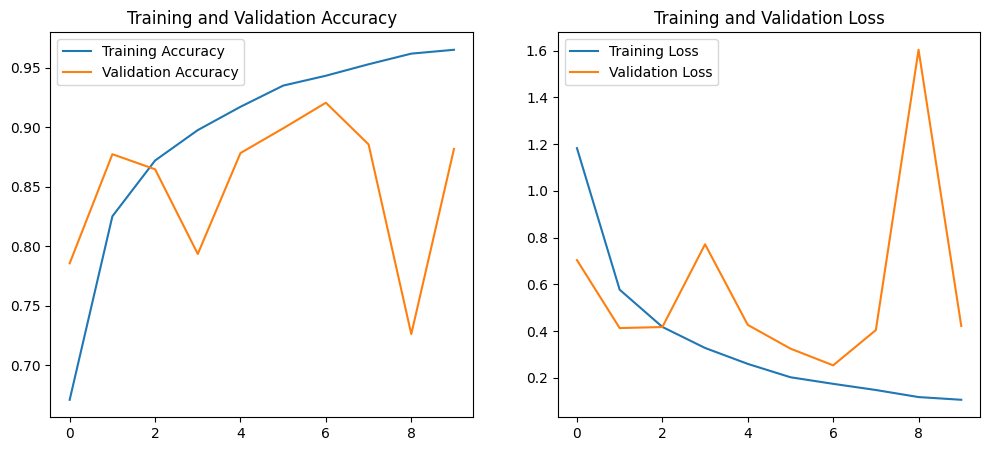

Running advanced model with augmented preprocessing...
Epoch 1/10
1188/1188 [==============================] - 48s 37ms/step - loss: 1.1767 - accuracy: 0.6754 - val_loss: 0.9245 - val_accuracy: 0.7372
Epoch 2/10
1188/1188 [==============================] - 45s 37ms/step - loss: 0.6276 - accuracy: 0.8120 - val_loss: 0.6635 - val_accuracy: 0.8165
Epoch 3/10
1188/1188 [==============================] - 45s 37ms/step - loss: 0.4834 - accuracy: 0.8523 - val_loss: 0.4144 - val_accuracy: 0.8713
Epoch 4/10
1188/1188 [==============================] - 45s 37ms/step - loss: 0.4535 - accuracy: 0.8621 - val_loss: 0.8575 - val_accuracy: 0.7649
Epoch 5/10
1188/1188 [==============================] - 45s 37ms/step - loss: 0.3095 - accuracy: 0.9032 - val_loss: 0.2604 - val_accuracy: 0.9191
Epoch 6/10
1188/1188 [==============================] - 45s 37ms/step - loss: 0.2613 - accuracy: 0.9171 - val_loss: 0.2189 - val_accuracy: 0.9321
Epoch 7/10
1188/1188 [==============================] - 45s 37ms/step

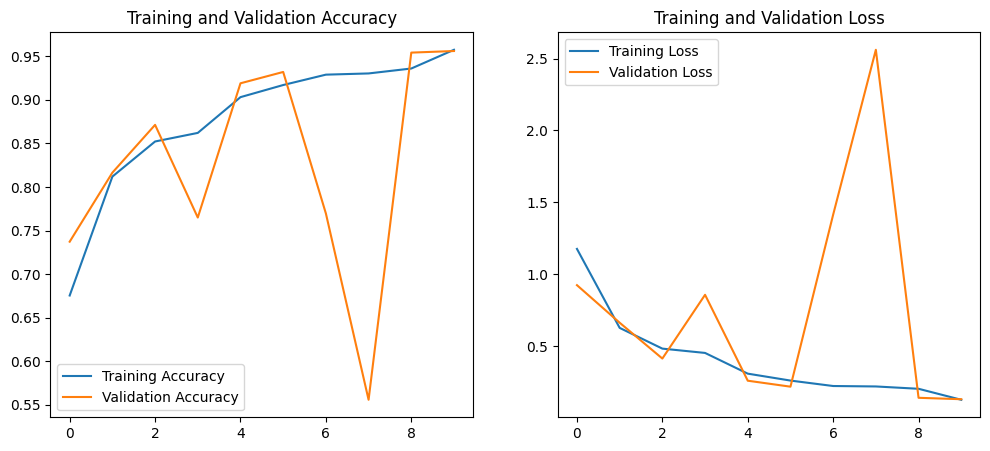

Best Model: advanced with augmented preprocessing
Best Validation Accuracy: 0.9561747908592224


In [ ]:
# Run all models with both types of preprocessing
results, best_model, best_model_details = run_all_models(preprocessing_types, model_types)

In [ ]:
# Extract an image from the augmented test dataset for visualization
for image, label in test_dataset_augmented.take(1):  # This takes one batch from the dataset
    sample_image = image[0]  # Take the first image in the batch

In [ ]:
best_model_details

{'model_type': 'advanced',
 'preprocessing': 'augmented',
 'accuracy': 0.9561747908592224,
 'history': <keras.src.callbacks.History at 0x7901d69a5d50>}

255/255 [==============================] - 5s 16ms/step


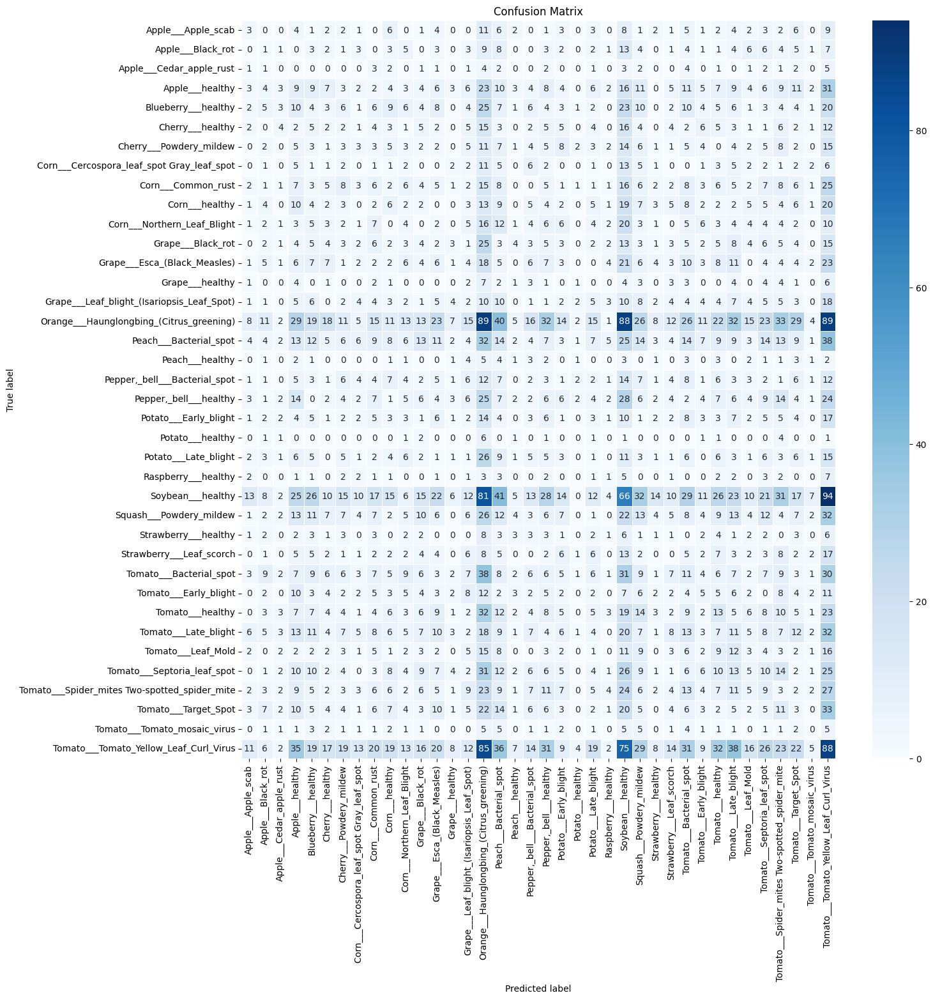

1/1 [==============================] - 0s 118ms/step


<Figure size 2000x2000 with 0 Axes>

<Figure size 2000x2000 with 0 Axes>

<Figure size 2000x2000 with 0 Axes>

<Figure size 2000x2000 with 0 Axes>

<Figure size 2000x2000 with 0 Axes>

In [ ]:
# Now call evaluate_best_model with the best model and the sample image
evaluate_best_model(best_model, test_dataset_augmented, info, sample_image)